# FEA Bending Modes

In [1]:
import numpy as np
import pandas as pd
import scipy.io

import matplotlib.pyplot as plt
import sys
sys.path.insert(0, '../')
from M1S_tools import *

plt.jet()

%matplotlib inline

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
## bending modes & influence matrices etc from Buddy #####################
ML actuators =  165 165
Afn =  (6991, 165)
fv =  (165, 165)
U matrix (6991, 165)
N node =  6991
## bending modes & influence matrices etc from Trupti #####################
N actuators =  170
Afz =  (27685, 170)
Afx =  (27685, 170)
Afy =  (27685, 170)
U matrix (27685, 170)
V matrix (170, 170)
S matrix (170, 170)
N node =  27685
number of Mirror Front surface TCs =  48
number of Mirror Back surface TCs =  48
number of Mirro

<Figure size 640x480 with 0 Axes>

In [2]:
dataFolder = '/Users/bxin/Library/CloudStorage/OneDrive-SharedLibraries-GMTOCorp/M1S Portal - Documents'
Dec24IFFolder = '/influnce_matrix_files/OA_influence_matrices_all/OA_surface_normal_normalised_20Dec2024/'
#read Afz (Fz influence matrix) - 01/02/2025. Trupti confirmed on slack that this is surface 
df = pd.read_csv(dataFolder+Dec24IFFolder+'Afz-20-Dec-2024.csv', header=None)
Afz = np.array(df)
print('Afz = ',Afz.shape)
# this is Afz only; it is 28789 x 176. last 6 being HPs

#read Afx (Fx influence matrix)
df = pd.read_csv(dataFolder+Dec24IFFolder+'Afx-20-Dec-2024.csv', header=None)
Afx = np.array(df)
print('Afx = ', Afx.shape)

#read Afy (Fy influence matrix)
df = pd.read_csv(dataFolder+Dec24IFFolder+'Afy-20-Dec-2024.csv', header=None)
Afy = np.array(df)
print('Afy = ', Afy.shape)

Afz =  (28789, 176)
Afx =  (28789, 176)
Afy =  (28789, 176)


In [3]:
#read Fz Bending Modes & forces (note: Uzm is for the moments.)
df = pd.read_csv(dataFolder+Dec24IFFolder+'Uz_norm-20-Dec-2024.csv', header=None)
UMat = np.array(df)
print('U matrix', UMat.shape)

df = pd.read_csv(dataFolder+Dec24IFFolder+'Sz_norm-20-Dec-2024.csv', header=None)
SMat = np.array(df)
print('S matrix', SMat.shape)

df = pd.read_csv(dataFolder+Dec24IFFolder+'Vz_norm-20-Dec-2024.csv', header=None)
VMat = np.array(df)
print('V matrix', VMat.shape)

U matrix (28789, 176)
S matrix (176, 176)
V matrix (176, 176)


In [4]:
#read FEA nodes data
df = pd.read_csv(dataFolder+Dec24IFFolder+'surfacenodes_M1B-20-Dec-2024.csv')
nodeID = np.array(df['nodeID'])
nodex = np.array(df['X'])
nodey = np.array(df['Y'])
nodez = np.array(df['Z'])
print('N node = ', len(nodeID), len(nodex))

N node =  28789 28789


In [5]:
# use these indices to remove surface nodes outside of CA
noder = np.sqrt(nodex**2+nodey**2)
insideCA = noder< np.max(nodex_ml) #diameter_of_CA/2.0
nodeID = nodeID[insideCA]
nodex = nodex[insideCA]
nodey = nodey[insideCA]
nodez = nodez[insideCA]
Afz = Afz[insideCA, :]

### Something wrong with Trupti's matrices

In [6]:
print(Afz[:3,:3])

#reconstruct Afz using U,S,V from Trupti
aa = UMat@SMat@VMat.transpose()
print(aa[:3,:3])

[[2.05532103e-09 1.37742536e-09 7.18681804e-10]
 [2.02407067e-09 1.35972011e-09 7.06044531e-10]
 [1.98253903e-09 1.33562264e-09 6.88780745e-10]]
[[3.61736501e-07 2.42426863e-07 1.26487997e-07]
 [3.56236438e-07 2.39310740e-07 1.24263838e-07]
 [3.48926869e-07 2.35069585e-07 1.21225411e-07]]


#### If we do our own SVD, we can reconstruct Afz without problem

In [7]:
#this takes ~1 minute
U, S, Vt = np.linalg.svd(Afz[:,:nact]) #here we exclude the HPs, because our force RMS should not include those

In [8]:
#reconstruct Afz using output matrices of above SVD
Sigma = np.zeros((Afz.shape[0], nact))  # Create a matrix of zeros with the shape of A
np.fill_diagonal(Sigma, S)  # Place the singular values on the diagonal
bb = U @ Sigma @ Vt
print(bb[:3,:3])

[[2.05532103e-09 1.37742536e-09 7.18681804e-10]
 [2.02407067e-09 1.35972011e-09 7.06044531e-10]
 [1.98253903e-09 1.33562264e-09 6.88780745e-10]]


In [9]:
U_TR = UMat.copy()
V_TR = VMat.copy()
VMat = VMat[:nact,:nact]

In [10]:
UMat = U[:,:nact] * np.sqrt(U.shape[0])
for modeID in range(1, Vt.shape[1]+1):
    VMat[:, modeID-1] = Vt.T[:, modeID-1] * 1e-6/S[modeID-1]*np.sqrt(UMat.shape[0])
    #1e-6 due to meter to micron conversion

### What does 1um surface become if we interpolate UMat to square grid?

### resample the surface to get to square grid.

In [11]:
from scipy.interpolate import griddata

# Generate grid
grid_spacing = 0.05 #this gives roughly 200 points in each direction. 40,000 nodes on the square that covers the circle
radius_of_CA = diameter_of_CA / 2
x = np.arange(-radius_of_CA, radius_of_CA + grid_spacing, grid_spacing)
y = np.arange(-radius_of_CA, radius_of_CA + grid_spacing, grid_spacing)
gridx, gridy = np.meshgrid(x, y)

#do a trial interpolation to determine the mask. 
#R = np.sqrt(gridx**2 + gridy**2)
#mask = R <= radius_of_CA
# using R will still give nan inside the mask, because there are grid point outside of all the (nodex,nodey)
grid_z = griddata((nodex, nodey), Afz[:,0], (gridx, gridy), method='linear')
mask = ~np.isnan(grid_z)
n_grid_node = np.sum(mask)
print(n_grid_node)

21958


In [12]:
UMat_grid = np.zeros((n_grid_node, nact))

#print("manually calculated RMS; numpy STD; numpy mean")
for modeID in np.arange(1,nact+1):
    grid_z = griddata((nodex, nodey), UMat[:,modeID-1], (gridx[mask], gridy[mask]), method='linear')
    UMat_grid[:,modeID-1] = grid_z
    #print('%d, %.2f, %.2f, %+.2f, %+.3f'%(modeID, np.sqrt(np.sum(UMat[:,modeID-1]**2)/UMat.shape[0] ), 
    #      np.std(UMat[:,modeID-1]), np.mean(UMat_ml[:,modeID-1]), np.std(UMat_grid[:,modeID-1])))

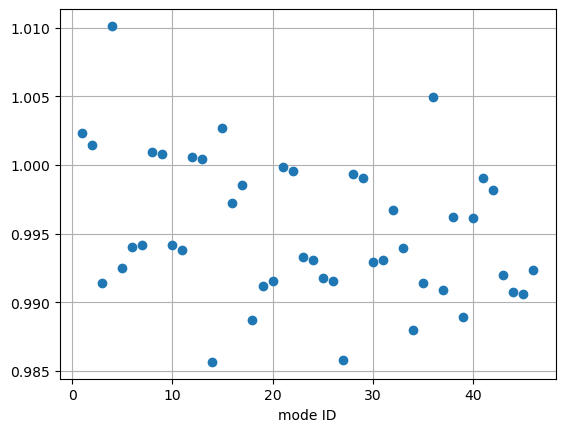

In [32]:
#plt.plot(np.std(UMat_grid, axis=0)[:-8], 'o') #plot looks similar for 162 modes.
#we show 46 modes only; 
#otherwise with the Zernike study we will have to explain the numerical effects which affects modes ~80 and above
plt.plot(np.arange(1,47), np.std(UMat_grid, axis=0)[:46], 'o')
plt.xlabel('mode ID')
plt.grid();

### I don't think decomposing UMat into Zernikes and calculating the RMS from Zernike will be any different. But Dave said so. and it is easy and fun to try it.

If we evaluate the Zernikes on FEA surface nodes, then decompose the surface into Zernikes on these surface nodes, it wouldn’t work. Because if the Zernikes are also numerically evaluated uneven grid, the area with denser surface nodes will dominate the decomposition into Zernikes as well.

In [116]:
#two many Zernikes may not be a good thing, because of numerical noise associated with the limited sampling
#more modes are needed for fitting higher order BMs, but too many will lead to large noise due to limited sampling
#it is a fight between these two factors. For each BM, the optimal number of Zernikes to use is different!
nzer = 200
zerU = np.zeros((UMat.shape[0], nzer))
for i in range(nzer):
    zerU[:,i] = zernike_polynomial(i+1, nodex/(radius_of_CA), nodey/(radius_of_CA))

In [117]:
#The sums below are limited by resolution
for i in range(8):
    print('rms - ', np.sqrt(np.mean(zerU[:,i]**2)), np.mean(zerU[:,i]), np.sum(zerU[:,i]) )
for i in range(5):    
    print('%+8.3f, %+8.3f'%(np.dot(zerU[:,i],zerU[:,i+5]), np.mean(np.multiply(zerU[:,i], zerU[:,i+5]))))

rms -  1.0 1.0 27547.0
rms -  0.9973399381296238 -2.93437743858366e-08 -0.0008083329530066408
rms -  0.997339977476906 -0.0032168692510566826 -88.61509725885844
rms -  1.0065152438805363 -0.009202400782524538 -253.49853435620344
rms -  0.9976465146664207 4.4606775597215166e-08 0.0012287828473764861
rms -  0.9976466679886955 -4.8062193352266725e-08 -0.0013239692402748915
rms -  1.009230548467045 0.0019892498849770506 54.79786658146281
rms -  1.0092306101909743 -1.581369750854799e-08 -0.00043561992526797155
  -0.001,   -0.000
  +0.001,   +0.000
  +0.001,   +0.000
 +40.754,   +0.001
  -1.422,   -0.000


In [118]:
np.dot(zerU[:,3], zerU[:,9])

0.0006150073849604532

In [119]:
newRMS = np.zeros((nact+1-8)) #5 duplicate quad forces, 3 for PTT
residualRMS = np.zeros_like(newRMS)
for modeID in np.arange(1,47): #nact+1-8):
    aa = zerU.transpose() / zerU.shape[0] @ UMat[:,modeID-1]
    newRMS[modeID-1] = np.sum(aa**2)
    residualRMS[modeID-1] = np.sqrt(np.mean((UMat[:,modeID-1] - zerU@aa)**2))
    print('%3d, %+8.3f, %+8.3f'%(modeID, newRMS[modeID-1], residualRMS[modeID-1]))

  1,   +1.000,   +0.076
  2,   +1.000,   +0.078
  3,   +1.017,   +0.070
  4,   +0.986,   +0.099
  5,   +1.019,   +0.094
  6,   +1.014,   +0.067
  7,   +1.014,   +0.069
  8,   +1.001,   +0.081
  9,   +1.001,   +0.082
 10,   +1.013,   +0.056
 11,   +1.013,   +0.058
 12,   +1.003,   +0.096
 13,   +1.003,   +0.095
 14,   +1.026,   +0.060
 15,   +0.996,   +0.075
 16,   +1.007,   +0.084
 17,   +1.004,   +0.063
 18,   +1.024,   +0.070
 19,   +1.018,   +0.059
 20,   +1.018,   +0.062
 21,   +1.003,   +0.089
 22,   +1.003,   +0.088
 23,   +1.013,   +0.051
 24,   +1.014,   +0.054
 25,   +1.017,   +0.053
 26,   +1.016,   +0.057
 27,   +1.026,   +0.066
 28,   +1.002,   +0.078
 29,   +1.002,   +0.077
 30,   +1.014,   +0.060
 31,   +1.014,   +0.065
 32,   +1.005,   +0.061
 33,   +1.010,   +0.075
 34,   +1.024,   +0.071
 35,   +1.017,   +0.064
 36,   +0.992,   +0.087
 37,   +1.018,   +0.068
 38,   +1.006,   +0.047
 39,   +1.020,   +0.058
 40,   +1.006,   +0.070
 41,   +1.001,   +0.082
 42,   +1.002,  

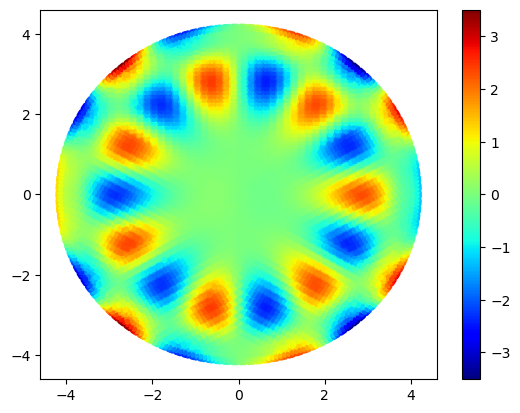

In [113]:
plt.scatter(nodex, nodey, 10, zerU@aa)
plt.colorbar();

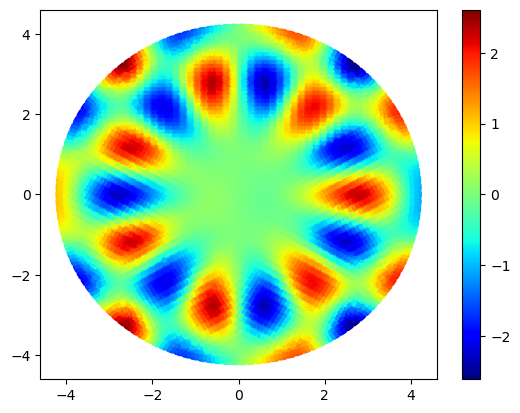

In [114]:
plt.scatter(nodex, nodey, 10, UMat[:,modeID-1])
plt.colorbar()

0.06616708834076412


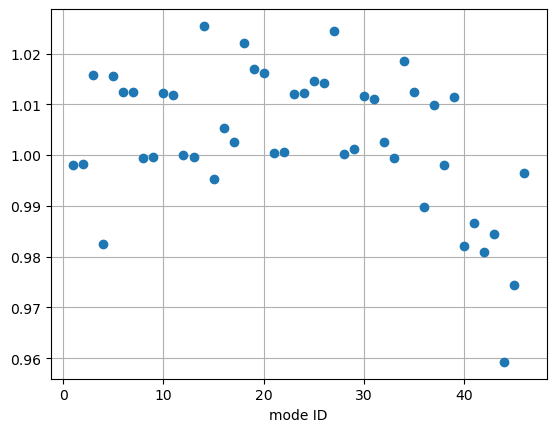

In [115]:
plt.plot(np.arange(1,47), newRMS[:46], 'o')
plt.xlabel('mode ID')
plt.grid();
print(np.max(newRMS[:46])-np.min(newRMS[:46]))

# if we resample Afz, it should be the best thing to do. 

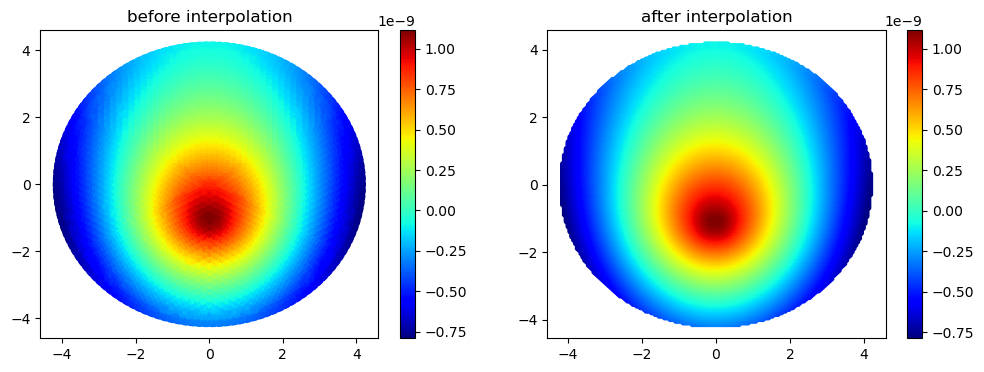

In [17]:


Afz_grid = np.zeros((n_grid_node, nact)) #here we exclude the HPs, because our force RMS should not include those
for i in range(nact):
    grid_z = griddata((nodex, nodey), Afz[:,i], (gridx, gridy), method='linear')
    Afz_grid[:,i] = grid_z[mask]

i=168
fig, ax = plt.subplots(1,2, figsize=(12,4))
img = ax[0].scatter(nodex, nodey, 10, Afz[:,i]) #-Afz[:,i+1])
fig.colorbar(img, ax=ax[0])
ax[0].set_title('before interpolation')
img = ax[1].scatter(gridx[mask], gridy[mask], 10, Afz_grid[:,i])
fig.colorbar(img, ax=ax[1])
ax[1].set_title('after interpolation');

#this takes ~1 minute
U, S, Vt = np.linalg.svd(Afz_grid) 

In [19]:
np.sum(np.isnan(Afz_grid))

0

## Next, we extract bending modes and their forces from our own SVD

In [20]:
print(Afz.shape, Afz_grid.shape)

(27547, 176) (21958, 170)


In [21]:
print(U.shape, S.shape, Vt.shape)

(21958, 21958) (170,) (170, 170)


In [25]:
UMat = U[:,:nact] * np.sqrt(U.shape[0])
for modeID in range(1, Vt.shape[1]+1):
    VMat[:, modeID-1] = Vt.T[:, modeID-1] * 1e-6/S[modeID-1]*np.sqrt(UMat.shape[0])
    #1e-6 due to meter to micron conversion

In [30]:
#check BM normalization
print("manually calculated RMS; numpy STD; numpy mean")
for modeID in np.arange(1,15): #nact+1):
    print('%d, %.2f, %.2f, %+.2f'%(modeID, np.sqrt(np.sum(UMat[:,modeID-1]**2)/UMat.shape[0] ), 
          np.std(UMat[:,modeID-1]), np.mean(UMat_ml[:,modeID-1]))) 

manually calculated RMS; numpy STD; numpy mean
1, 1.00, 1.00, -0.00
2, 1.00, 1.00, -0.00
3, 1.00, 1.00, +0.00
4, 1.00, 1.00, -0.00
5, 1.00, 1.00, +0.00
6, 1.00, 1.00, -0.00
7, 1.00, 1.00, -0.00
8, 1.00, 1.00, -0.00
9, 1.00, 1.00, +0.00
10, 1.00, 1.00, -0.00
11, 1.00, 1.00, +0.00
12, 1.00, 1.00, -0.00
13, 1.00, 1.00, +0.00
14, 1.00, 1.00, -0.00


In [31]:
#check BM force normalization
print("modeID; manually calculated RMS; RSS; numpy STD; numpy mean")
for i in np.arange(0,16):
    print('%3d, %8.1f, %8.1f, %8.1f, %+.2f'%(i+1, np.sqrt(np.sum(VMat[:,i]**2)/VMat.shape[0] ), 
                                         np.sqrt(np.sum(VMat[:,i]**2) ), 
          np.std(VMat[:,i]), np.mean(VMat[:,i])))

modeID; manually calculated RMS; RSS; numpy STD; numpy mean
  1,      5.5,     71.8,      5.5, -0.00
  2,      5.6,     72.9,      5.6, -0.01
  3,     15.3,    199.0,     15.3, -0.06
  4,     30.1,    393.1,     30.1, +0.00
  5,     32.2,    420.1,     32.2, +0.04
  6,     68.7,    895.3,     68.7, +0.00
  7,     73.2,    954.4,     73.2, +0.00
  8,     91.9,   1197.9,     91.9, -0.00
  9,     93.4,   1218.2,     93.4, +0.05
 10,    188.2,   2453.9,    188.2, -0.02
 11,    199.6,   2603.0,    199.6, +0.03
 12,    200.0,   2607.9,    200.0, +0.04
 13,    206.5,   2692.3,    206.5, +0.02
 14,    225.7,   2942.9,    225.6, -6.67
 15,    362.9,   4731.2,    362.9, -0.04
 16,    383.2,   4996.7,    383.0, +13.54


Looking at original data from Trupti

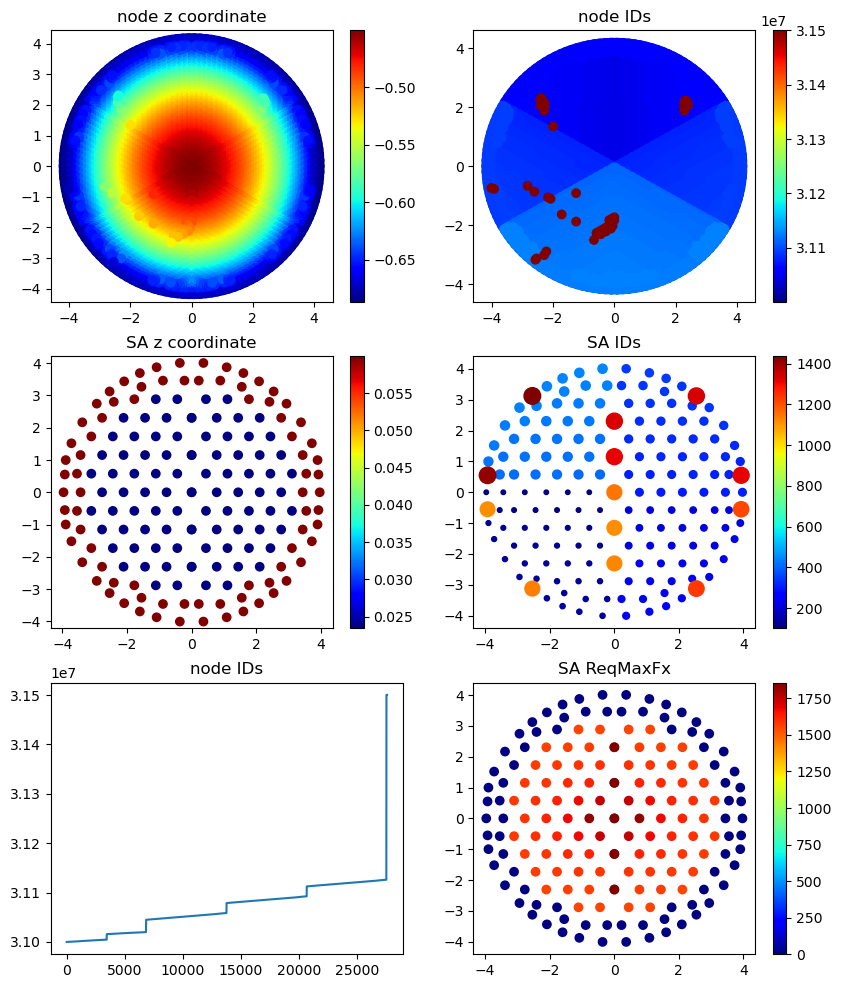

In [32]:
fig, ax = plt.subplots(3,2, figsize=(10,12))
img = ax[0][0].scatter(nodex, nodey, c=nodez)
fig.colorbar(img, ax=ax[0][0])
img = ax[0][1].scatter(nodex, nodey, c=nodeID)
fig.colorbar(img, ax=ax[0][1])
img = ax[1][1].scatter(sax, say, saID*0.1, c=saID)
fig.colorbar(img, ax=ax[1][1])
img = ax[1][0].scatter(sax, say, c=saz)
fig.colorbar(img, ax=ax[1][0])
img = ax[2][1].scatter(sax, say, c=saReqMaxFx_N)
fig.colorbar(img, ax=ax[2][1])
ax[2][0].plot(nodeID)
ax[0][0].set_title('node z coordinate')
ax[0][1].set_title('node IDs')
ax[1][0].set_title('SA z coordinate')
ax[1][1].set_title('SA IDs');
ax[2][0].set_title('node IDs')
ax[2][1].set_title('SA ReqMaxFx')
for i in range(3):
    for j in range(2):
        if not i==2 and j==0:
            ax[i][j].axis('equal')       

# In M1B, the 5 Quads are along y-axis !!! 

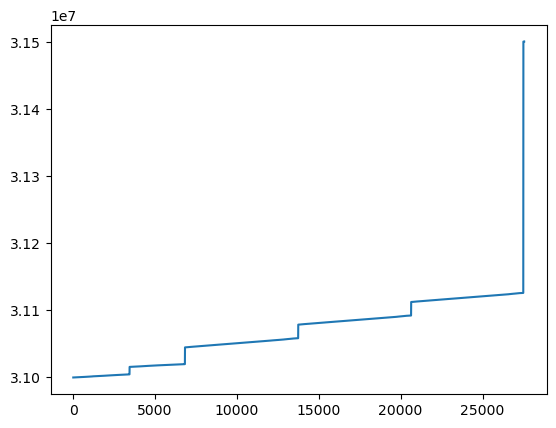

In [33]:
plt.plot(nodeID)

# Read in ML data so we can compare

In [34]:
dataFolder = '../model_data'

#read SA data
dfSA = scipy.io.loadmat(dataFolder+'/actCoords_ml.mat')
sax_ml = dfSA['yAct']/1e3 #turn into meter #swap x/y to get to M1B (M1DCS uses M1B!!!)
say_ml = dfSA['xAct']/1e3 #turn into meter
print('ML actuators = ', len(sax_ml), len(say_ml))

#read Afz (Fz influence matrix)
df = scipy.io.loadmat(dataFolder+'/influenceFunctions_ml.mat')
Afn_ml = df['interactionMat']
fv_ml = df['forceMat'] #fv = fv^T
print('Afn = ',Afn_ml.shape)
print('fv = ', fv_ml.shape)
# this is Afz only; it is 6991 x 170.

#read Fz Bending Mode 
mat = scipy.io.loadmat(dataFolder+'/SVD_ml.mat')
UMat_ml = mat['U']
SMat_ml = mat['S']
VMat_ml = mat['V']
print('U matrix', UMat_ml.shape)

#read FEA nodes data
mat = scipy.io.loadmat(dataFolder+'/nodeCoords_ml.mat')
nodex_ml = mat['y']/1e3 #turn into meter #swap x/y to get to M1B (M1DCS uses M1B!!!)
nodey_ml = mat['x']/1e3 #turn into meter
print('N node = ', len(nodex_ml))

############normalize bending modes to RMS = 1um ###################
UMat_ml *= np.sqrt(UMat_ml.shape[0])
for modeID in range(1, UMat_ml.shape[1]+1):
    VMat_ml[:, modeID-1] *= 1e3/SMat_ml[modeID-1, modeID-1]*np.sqrt(UMat_ml.shape[0]) 
    #1e3 due to nanometer to micron conversion; RFCML mode shapes are in nanometers

ML actuators =  165 165
Afn =  (6991, 165)
fv =  (165, 165)
U matrix (6991, 165)
N node =  6991


Text(0.5, 1.0, 'Actuator IDs and locations in M1-B Coordinate System')

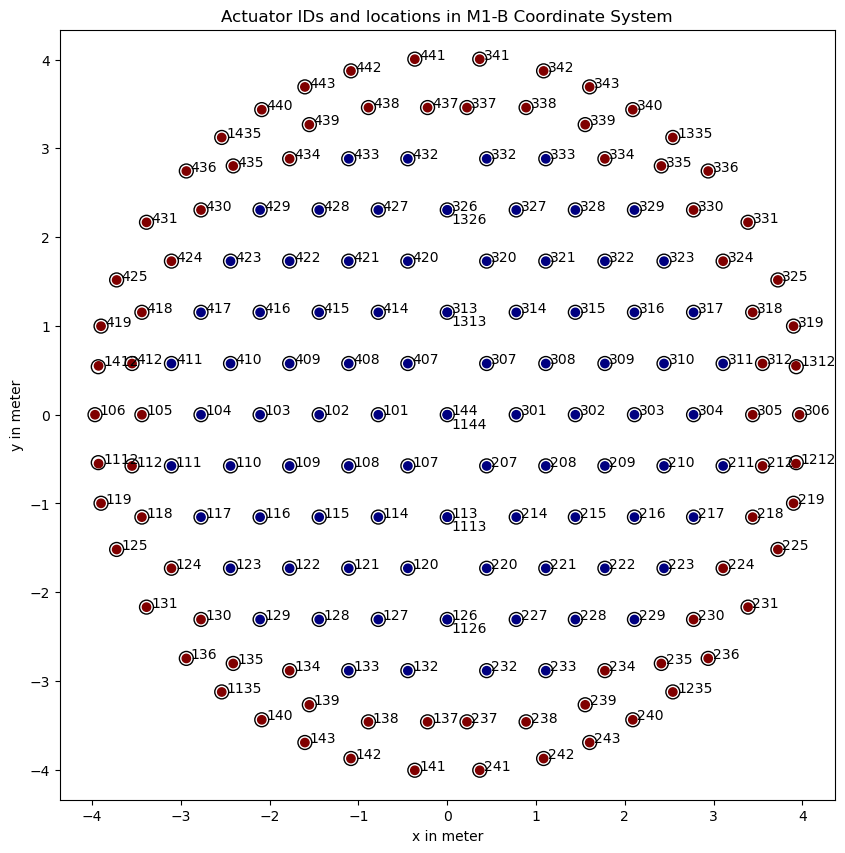

In [35]:
fig, ax = plt.subplots(1,1,figsize=(10,10))
plt.scatter(sax, say, c=saz)
plt.scatter(sax_ml, say_ml, s=100, facecolors='none', edgecolors='k')
for i in range(len(sax)):
    if (np.any(abs(sax[i]+say[i]-sax[:i]-say[:i])<1e-4)):
        plt.text(sax[i]+.05, say[i]-0.15, str(saID[i]))
    else:
        plt.text(sax[i]+.05, say[i], str(saID[i]))
plt.axis('equal')
plt.xlabel('x in meter')
plt.ylabel('y in meter')
plt.title('Actuator IDs and locations in M1-B Coordinate System')
#plt.grid()
#170 labels
#165 solid circles
#165 open circles

In [36]:
#only need to be executed when ID mapping has not been loaded.
saID_ml = np.zeros(len(sax_ml))
sa_offset = np.zeros(len(sax_ml))
for i in range(len(sax_ml)):
    offsetVec = np.hypot(sax_ml[i]-sax, say_ml[i]-say)
    found = np.where(offsetVec<0.1)[0] #less than 0.1meter
    #print(found)
    if len(found)==1:
        offset = offsetVec[found]
        saID_ml[i] = int(saID[found])
    else: #if found more than 1 GMT ID around the ML act.
        offset = offsetVec[found[0]]
        saID_ml[i] = saID[found[0]]*1e6+saID[found[1]]
    sa_offset[i] = offset
        #print()
    #else:
    #    print(i, saID[i],sax_ml[i], say_ml[i], found, offset)
    #    print(((abs(sax_ml[i]+say_ml[i]-sax-say)<0.1)))

In [37]:
#see figure above, 1112 is at between 8 o'clock and 9 o'clock
sax[saID==1112], sax_ml[saID_ml==1112]

(array([-3.92794]), array([[-3.93106656]]))

In [38]:
say[saID==1112], say_ml[saID_ml==1112]

(array([-0.551401]), array([[-0.54024505]]))

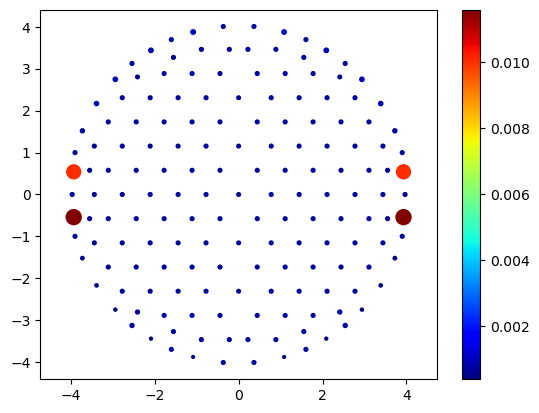

In [39]:
#show where the largest offsets are
plt.scatter(sax_ml, say_ml, .1e5*sa_offset, c=sa_offset)
plt.axis('equal')
plt.colorbar();

In [40]:
saID

array([ 101,  102,  103,  104,  105,  106,  107,  108,  109,  110,  111,
        112,  114,  115,  116,  117,  118,  119,  120,  121,  122,  123,
        124,  125,  127,  128,  129,  130,  131,  132,  133,  134,  135,
        136,  137,  138,  139,  140,  141,  142,  143,  207,  208,  209,
        210,  211,  212,  214,  215,  216,  217,  218,  219,  220,  221,
        222,  223,  224,  225,  227,  228,  229,  230,  231,  232,  233,
        234,  235,  236,  237,  238,  239,  240,  241,  242,  243,  301,
        302,  303,  304,  305,  306,  307,  308,  309,  310,  311,  312,
        314,  315,  316,  317,  318,  319,  320,  321,  322,  323,  324,
        325,  327,  328,  329,  330,  331,  332,  333,  334,  335,  336,
        337,  338,  339,  340,  341,  342,  343,  407,  408,  409,  410,
        411,  412,  414,  415,  416,  417,  418,  419,  420,  421,  422,
        423,  424,  425,  427,  428,  429,  430,  431,  432,  433,  434,
        435,  436,  437,  438,  439,  440,  441,  4

In [41]:
#print out saID_ml
for i in range(len(saID_ml)):
    print('%d'%saID_ml[i], end=' ')
    if i%10==9:
        print()

443 419 143 119 412 112 1435 1135 441 442 
440 436 431 439 425 106 141 142 140 136 
131 139 125 407 420 432 437 414 427 438 
421 433 415 428 422 434 416 429 435 423 
417 430 424 408 409 101 102 410 411 1412 
418 103 104 105 107 120 132 137 114 127 
138 121 133 115 128 122 134 116 129 135 
123 117 130 124 108 109 110 111 1112 118 
144001144 313001313 326001326 113001113 126001126 343 319 243 219 312 
212 1335 1235 341 342 340 336 331 339 325 
306 241 242 240 236 231 239 225 307 320 
332 337 314 327 338 321 333 315 328 322 
334 316 329 335 323 317 330 324 308 309 
301 302 310 311 1312 318 303 304 305 207 
220 232 237 214 227 238 221 233 215 228 
222 234 216 229 235 223 217 230 224 208 
209 210 211 1212 218 

In [42]:
#buddy did not give me act IDs. modeID just goes 1,2,3....,165
aa = np.zeros(171)
for modeID in range(1,171):
    aa[modeID-1] = saID2mlModeID(saID[modeID-1])
    print(aa[modeID-1], end= '  ')
print('\n max = %.0f '%np.max(aa))

46.0  47.0  52.0  53.0  54.0  16.0  55.0  75.0  76.0  77.0  78.0  6.0  59.0  64.0  68.0  72.0  80.0  4.0  56.0  62.0  66.0  71.0  74.0  23.0  60.0  65.0  69.0  73.0  21.0  57.0  63.0  67.0  70.0  20.0  58.0  61.0  22.0  19.0  17.0  18.0  3.0  140.0  160.0  161.0  162.0  163.0  91.0  144.0  149.0  153.0  157.0  165.0  89.0  141.0  147.0  151.0  156.0  159.0  108.0  145.0  150.0  154.0  158.0  106.0  142.0  148.0  152.0  155.0  105.0  143.0  146.0  107.0  104.0  102.0  103.0  88.0  131.0  132.0  137.0  138.0  139.0  101.0  109.0  129.0  130.0  133.0  134.0  90.0  113.0  118.0  122.0  126.0  136.0  87.0  110.0  116.0  120.0  125.0  128.0  100.0  114.0  119.0  123.0  127.0  98.0  111.0  117.0  121.0  124.0  97.0  112.0  115.0  99.0  96.0  94.0  95.0  86.0  24.0  44.0  45.0  48.0  49.0  5.0  28.0  33.0  37.0  41.0  51.0  2.0  25.0  31.0  35.0  40.0  43.0  15.0  29.0  34.0  38.0  42.0  13.0  26.0  32.0  36.0  39.0  12.0  27.0  30.0  14.0  11.0  9.0  10.0  1.0  79.0  8.0  164.0  93.0  135.0  

In [43]:
#only need to be executed when ID mapping has not been loaded.
#np.savetxt('saID_ml.txt', saID_ml)

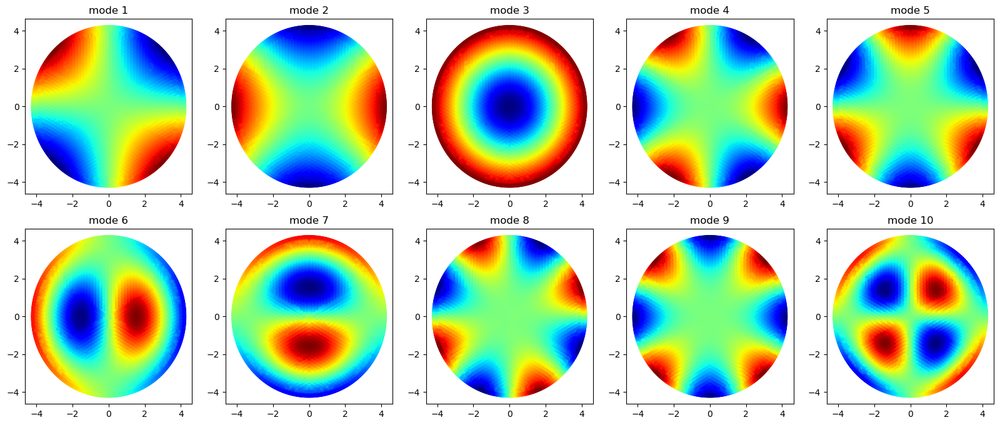

In [32]:
nrow = 2 #take ~2 minutes to run 15 rows
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for modeID in range(1,5*nrow+1):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    i += 1

    img = ax[irow][icol].scatter(nodex, nodey,10, U_TR[:,modeID-1])
    ax[irow][icol].set_title('mode %d'%modeID)
#These are Trupti's modes

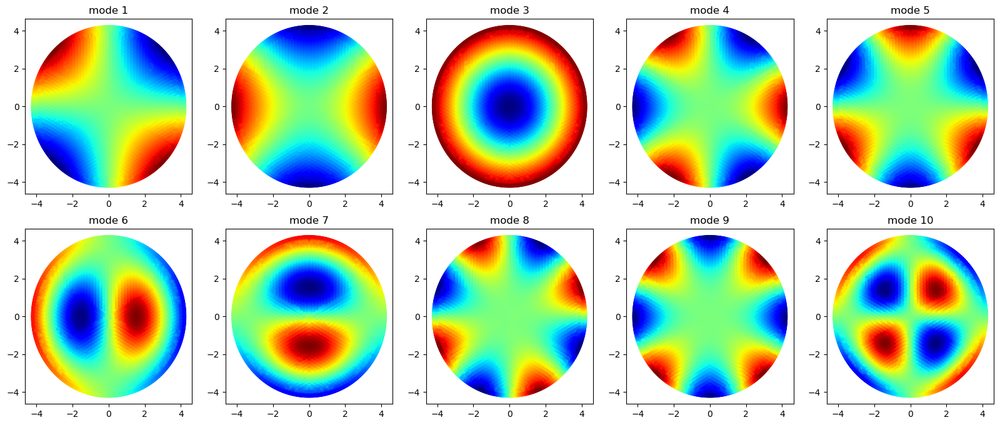

In [31]:
nrow = 2 #take ~2 minutes to run 15 rows
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for modeID in range(1,5*nrow+1):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    i += 1

    img = ax[irow][icol].scatter(nodex, nodey,10, UMat[:,modeID-1])
    ax[irow][icol].set_title('mode %d'%modeID)
#These are BX's modes

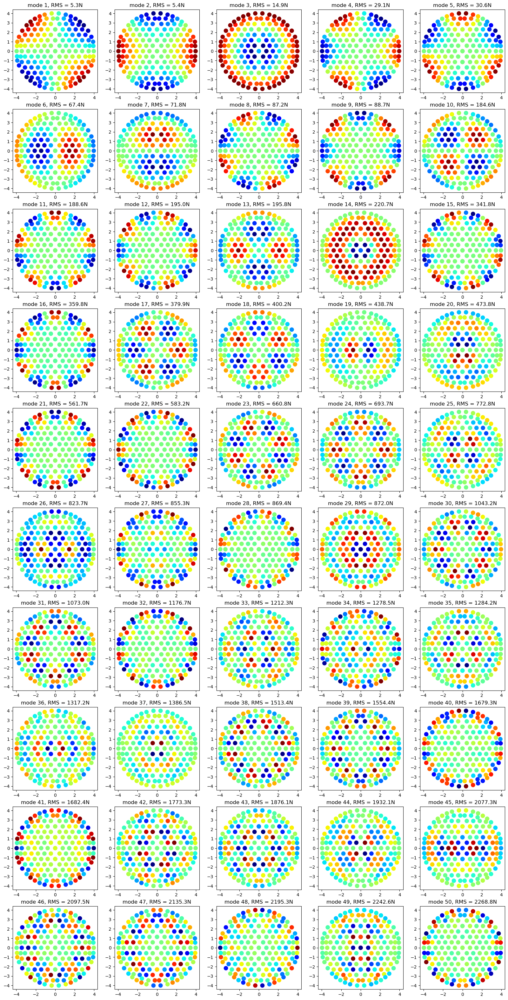

In [61]:
nrow = 10
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for modeID in range(1,5*nrow+1):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    i += 1

    img = ax[irow][icol].scatter(sax, say,80, VMat[:,modeID-1])
    ax[irow][icol].set_title('mode %d, RMS = %.1fN'%(modeID, np.std(VMat[:,modeID-1])))
#These are Trupti's modes

In [44]:
max(nodeID)

31500165

In [45]:
#double check gmtFvec2mlFvec() does not mess up the quad forces
print(np.sum(gmtFvec2mlFvec(VMat[:,i])), np.sum((VMat[:,i])))

12130072.720656127 12130072.720656127


# side by side comparison with ML bending modes

In [46]:
from scipy.interpolate import LinearNDInterpolator 
#we interpolate GMT BMs onto ML surface nodes to figure out any sign difference between the two sets of BMs

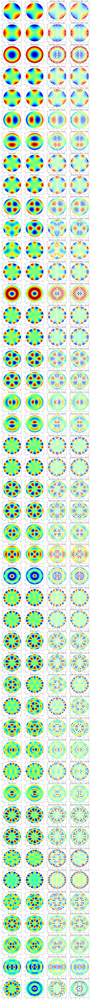

In [50]:
nrow = 46
fig, ax = plt.subplots(nrow,4,figsize=(16,4*nrow))
i = 0
for modeID in range(1,nrow+1):
    sign_flip = 1
    interp = LinearNDInterpolator(list(zip(gridx[mask], gridy[mask])), UMat[:, modeID-1], fill_value=0)
    mapOntoML = interp(nodex_ml, nodey_ml).ravel()
    if np.std(mapOntoML+UMat_ml[:,modeID-1])<np.std(UMat_ml[:,modeID-1]):
        sign_flip = -1 #-1 means we need to flip
    #print(sign_flip)
    for j in range(4):
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        
        if j==0:
            img = ax[irow][icol].scatter(gridx[mask], gridy[mask],10, UMat[:,modeID-1]*sign_flip)
            ax[irow][icol].set_title('GMT mode %d'%modeID)
        elif j==1:
            img = ax[irow][icol].scatter(nodex_ml, nodey_ml,10, UMat_ml[:,modeID-1])
            ax[irow][icol].set_title('RFCML mode %d'%modeID)    
        elif j==2:
            img = ax[irow][icol].scatter(sax, say,80, VMat[:,modeID-1]*sign_flip)
            ax[irow][icol].set_title('GMT Force %d, RMS = %.1fN'%(modeID, np.std(VMat[:,modeID-1])))
        elif j==3:
            #we convert ML force map to GMT acts, otherwise the quads visually differ by 2x.
            img = ax[irow][icol].scatter(sax, say,80, mlFvec2gmtFvec(VMat_ml[:,modeID-1]))
            ax[irow][icol].set_title('RFCML Force %d, RMS =  %.1fN'%(modeID, np.std(mlFvec2gmtFvec(VMat_ml[:,modeID-1]))))

In [53]:
modeID = 1
print(np.sqrt(np.mean((UMat_ml[:,modeID-1])**2)))
print(np.sqrt(np.mean((UMat[:,modeID-1])**2)))
print(np.sqrt(np.mean((VMat_ml[:,modeID-1])**2)))
print(np.sqrt(np.mean((VMat[:,modeID-1])**2)))

0.9999999999999994
1.0000000000000016
6.619004334934111
5.326282094643539


In [52]:
#This takes 15 minutes to run
xtalk = np.zeros((46, 46))
for i in range(46):
    # method 1 (not good)
    # we pretend ML modes are real BMs. We use GMT BMs to run the tests, 
    # we characterize the xtalk by decomposing each GMT mode onto ML modes.
    # xtalk[i,j] is the ith coeff when jth ML mode is decomposed onto all GMT modes.
    #for BM#1, GMT says 5.6N RMS is needed to get 1um BM. ML says no, 6.6N. 
    #ML mode is stiffer. same force = less surf RMS bend. we want this to show up as xtalk[0,0]<1
    # PROBLEM: some modes diff by mostly a rotation angle. These show up as off-diagonal elements
    
    #interp = LinearNDInterpolator(list(zip(nodex, nodey)), UMat[:, i], fill_value=0)
    #mapOntoML = interp(nodex_ml, nodey_ml).ravel()
    #aa = UMat_ml.transpose() /UMat_ml.shape[0] @ mapOntoML
    #xtalk[:,i] = np.abs(aa[:46]) #sometimes the signs are reversed by ML and GMT
    
    #method 2
    # use ML influence matrix, multiple with GMT BM forces, get the mode shapes, decompose onto GMT BMs.
    #1e-3 due to nanometer to micron conversion; RFCML mode shapes are in nanometers
    ss_mlgrid = Afn_ml @ gmtFvec2mlFvec(VMat[:,i]) * 1e-3
    interp = LinearNDInterpolator(list(zip(np.squeeze(nodex_ml), np.squeeze(nodey_ml))), ss_mlgrid, fill_value=0)
    mapOntoGMT = interp(gridx[mask], gridy[mask]).ravel()
    aa = UMat.transpose() / UMat.shape[0] @ mapOntoGMT
    xtalk[:, i] = aa[:46]

Text(0.05, 0.5, 'Force to Surface conversion \n via RFCML influence matrix')

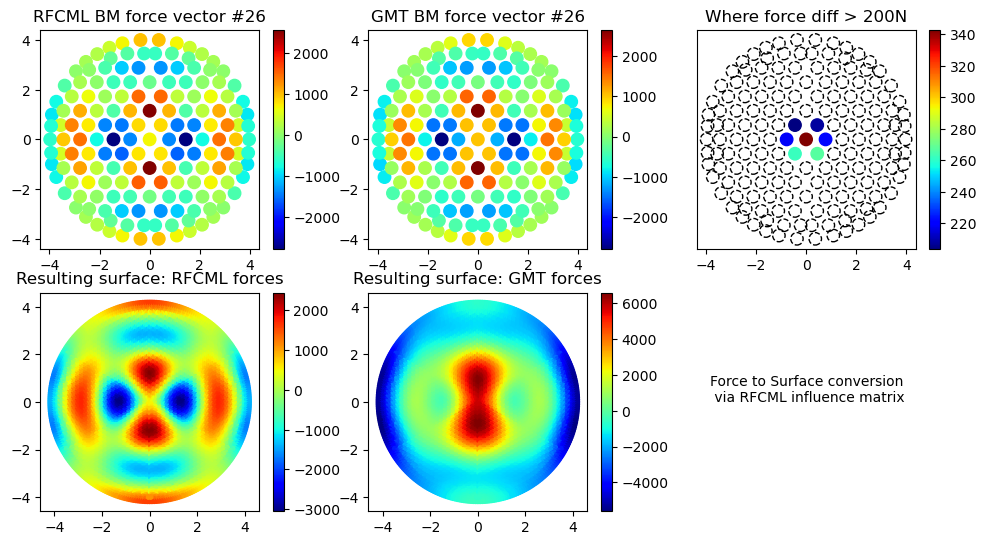

In [57]:
fig, ax = plt.subplots(2,3, figsize=(12,6.25))

modeID = 26
f1 = VMat_ml[:,modeID-1] #ML force for this bm
f2 = gmtFvec2mlFvec(VMat[:,modeID-1]) #GMT force for this bm, converted onto ML force vector format
img = ax[0][0].scatter(sax_ml, say_ml,80, f1)
fig.colorbar(img, ax=ax[0][0])
ax[0][0].set_title("RFCML BM force vector #%d"%modeID)

img = ax[0][1].scatter(sax_ml, say_ml,80, f2)
fig.colorbar(img, ax=ax[0][1])
ax[0][1].set_title('GMT BM force vector #%d'%modeID)

idx = np.abs(f1-f2)>200
img = ax[0][2].scatter(sax_ml[~idx], say_ml[~idx],80, marker='o', facecolors='none', edgecolors='k', linestyle='--')
img = ax[0][2].scatter(sax_ml[idx], say_ml[idx],80, f2[idx]-f1[idx])
fig.colorbar(img, ax=ax[0][2])
ax[0][2].set_yticks([])
ax[0][2].set_title('Where force diff > 200N')

img = ax[1][0].scatter(nodex_ml, nodey_ml, 10, Afn_ml @ f1)
fig.colorbar(img, ax=ax[1][0])
ax[1][0].set_title('Resulting surface: RFCML forces')
ax[1][1].set_title('Resulting surface: GMT forces')

img = ax[1][1].scatter(nodex_ml, nodey_ml, 10, Afn_ml @ f2)
fig.colorbar(img, ax=ax[1][1])
ax[1][2].axis('off')
ax[1][2].text(.05, .5, 'Force to Surface conversion \n via RFCML influence matrix')

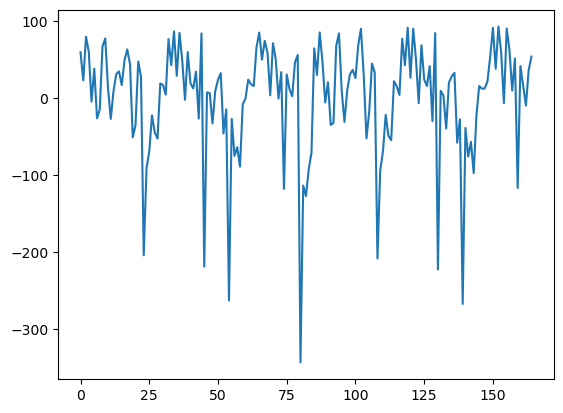

In [58]:
plt.plot(f1-f2)

In [117]:
print(np.std(V_TR[:,26]), np.std(VMat[:,26]))
print(V_TR[:,26].shape, VMat[:,26].shape)

0.9999999999999994 873.6361253857816
(176,) (170,)


In [59]:
np.max(nodex), np.max(nodex_ml), np.max(nodey_ml)

(4.18097218296512, 4.181, 4.187600000000001)

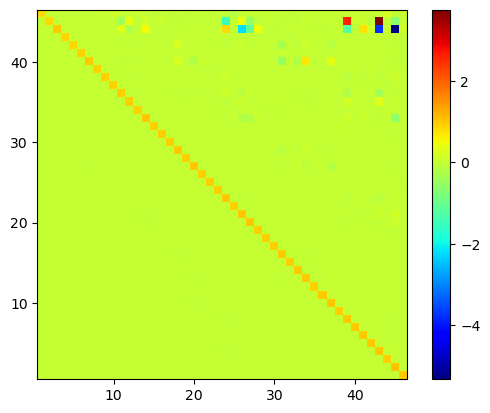

In [54]:
nx = 46
plt.imshow(xtalk[:nx,:nx], extent=[.5, nx+.5, .5, nx+.5])
plt.colorbar();

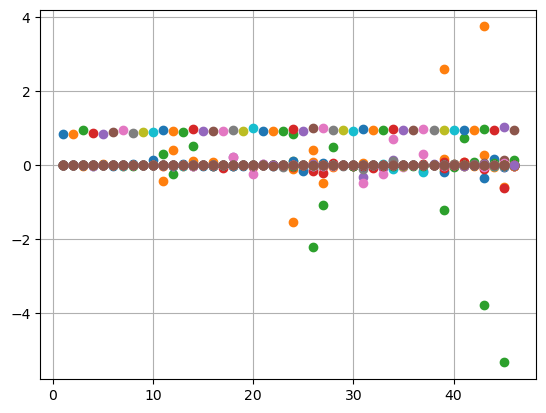

In [55]:
plt.plot(range(1,nx+1),xtalk[:nx,:nx].transpose(),'o');
plt.grid();

## GMT single SA IF (influenceMat * [0 0 1 0 0 ... 0])

In [6]:
TR_IDs = np.loadtxt('SA_ID_for_IF.txt')

In [8]:
idx = np.zeros(nact)
for ii in range(nact):
    if saID[ii] in TR_IDs:
        if saz[ii]>0.04:
            idx[ii] = 1
        else:
            idx[ii] = 3

In [10]:
sax[idx!=0]

array([-1.77548, -2.93919,  1.77548,  2.93919,  1.77547,  2.93908,
       -1.77548, -2.93908,  0.     ,  0.     ,  0.     ,  0.     ,
        0.     ,  0.     ,  0.     ,  0.     ,  0.     ,  0.     ])

Text(0.5, 1.0, 'Actuator IDs and locations in M1-B Coordinate System')

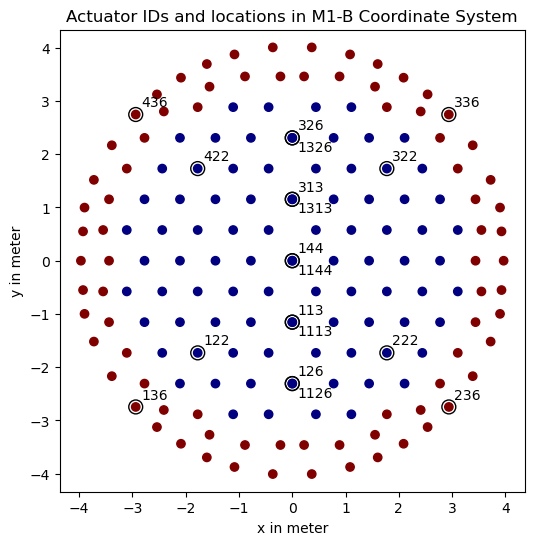

In [16]:
fig, ax = plt.subplots(1,1,figsize=(6,6))
plt.scatter(sax, say, c=saz)
plt.scatter(sax[idx!=0], say[idx!=0], s=100, facecolors='none', edgecolors='k')
for i in range(len(sax)):
    if idx[i] != 0:
        if (np.any(abs(sax[i]+say[i]-sax[:i]-say[:i])<1e-4)):
            plt.text(sax[i]+.1, say[i]-0.25, str(saID[i]))
        else:
            plt.text(sax[i]+.1, say[i]+0.15, str(saID[i]))
plt.axis('equal')
plt.xlabel('x in meter')
plt.ylabel('y in meter')
plt.title('Actuator IDs and locations in M1-B Coordinate System')

In [17]:
Afz.shape

(27685, 170)

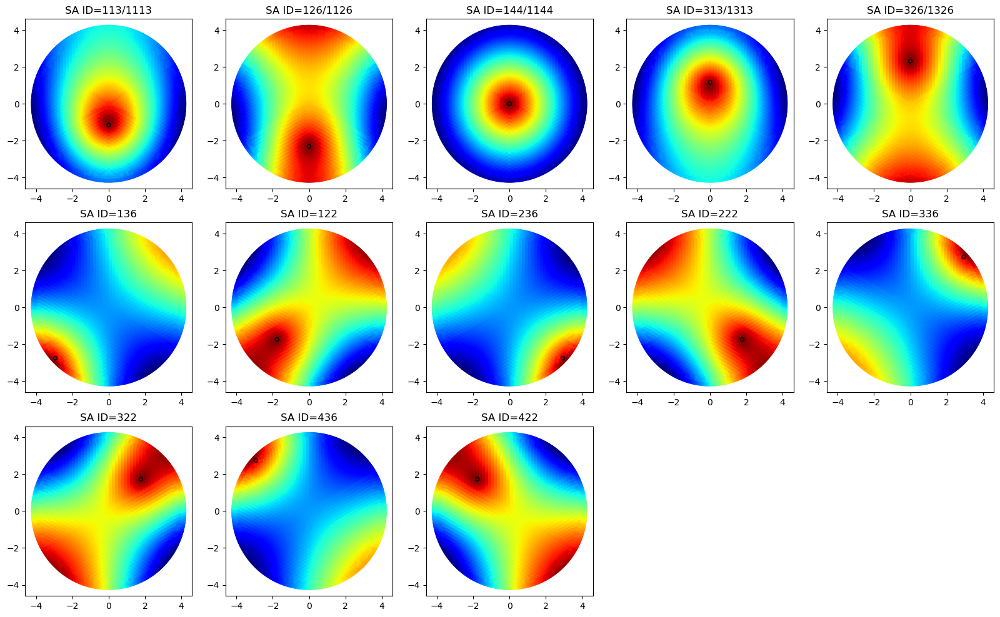

In [26]:
nrow = 3
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for mysaID in TR_IDs:

    if mysaID < 1000:
        modeID = np.argmax(saID==mysaID)+1
        irow = np.int8(i/5)
        icol = np.mod(i,5)
        i += 1

        img = ax[irow][icol].scatter(nodex, nodey,10, Afz[:,modeID-1])
        if mysaID in TR_IDs[:10]:
            ax[irow][icol].set_title('SA ID=%d/%d'%(saID[modeID-1], saID[modeID-1]+1000))
        else:
            ax[irow][icol].set_title('SA ID=%d'%(saID[modeID-1]))
        circle = plt.Circle((sax[modeID-1], say[modeID-1]),0.1, fill=False)
        ax[irow][icol].add_artist(circle)
endMode = i
for i in range(endMode, nrow*5):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    ax[irow][icol].axis('off')

In [22]:
i

13

## Side by side comparison with ML single SA IF

In [28]:
IF_ml = Afn_ml @ fv_ml

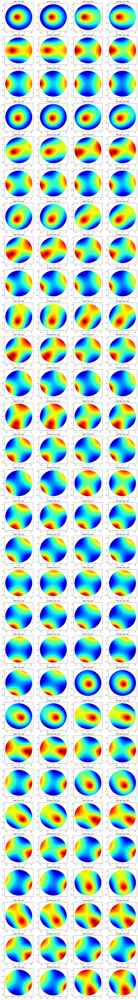

In [29]:
nrow = 30
fig, ax = plt.subplots(nrow,4,figsize=(16,4*nrow))
i = 0
for modeID in range(1,2*nrow+1):
    for j in range(2):
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        
        if j==0:
            img = ax[irow][icol].scatter(nodex, nodey,10, Afz[:,modeID-1])
            ax[irow][icol].set_title('GMT SA %d'%saID[modeID-1])
            circle = plt.Circle((sax[modeID-1], say[modeID-1]),0.1, fill=False)
            ax[irow][icol].add_artist(circle)
        else:
            modeID_ml = saID2mlModeID(saID[modeID-1]) #we want modeID_ml to start from 1 as well
            img = ax[irow][icol].scatter(nodex_ml, nodey_ml,10, IF_ml[:,modeID_ml-1])
            ax[irow][icol].set_title('RFCML SA %d'%saID_ml[modeID_ml-1])   
            circle = plt.Circle((sax_ml[modeID_ml-1], say_ml[modeID_ml-1]),0.1, fill=False)
            ax[irow][icol].add_artist(circle)